In [1]:
# 1.0 Call libraries
%reset -f
# 1.1 For data manipulations
import numpy as np
import pandas as pd
from numpy.random import default_rng

# 1.2 For plotting
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib as mpl     # For creating colormaps

# 1.5 Model pipelining
from sklearn.pipeline import Pipeline
from sklearn.pipeline import make_pipeline

# 1.3 For data processing
from sklearn.preprocessing import StandardScaler 
from sklearn.decomposition import PCA
from xgboost.sklearn import XGBClassifier

# 1.6 Hyperparameter optimization
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RandomizedSearchCV


# 1.4 OS related
import os

# 1.5 for working in ipython
#%matplotlib qt5
#%matplotlib inline
# 1.9 Model evaluation metrics
from sklearn.metrics import accuracy_score, f1_score
from sklearn.metrics import plot_roc_curve
from sklearn.metrics import confusion_matrix

# 1.10
import matplotlib.pyplot as plt
import seaborn as sns
from xgboost import plot_importance

# 1.11 Permutation feature importance
from sklearn.inspection import permutation_importance

In [2]:
#1.6 From a cell display outputs from multiple commands:
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

In [3]:
# 1.6.1 For generating random numbers:
rng = default_rng()

In [4]:
res=pd.read_csv("train 2.csv")

In [5]:
res_test=pd.read_csv("test 2.csv")

In [6]:
print("\n Shape")
res.shape                # 100039, 33)
print("\n\n Columns")
res.columns.values       # Label column is the last one
print("\n")

# 3.0.1
print("\n\nTarget distribution")
res.revenue.value_counts()  # Classes are not unbalanced
                           # Binary data
                           #  b: 65558 , s: 34242
print("\n")
res.head(3)


 Shape


(137, 43)



 Columns


array(['Id', 'Open Date', 'City', 'City Group', 'Type', 'P1', 'P2', 'P3',
       'P4', 'P5', 'P6', 'P7', 'P8', 'P9', 'P10', 'P11', 'P12', 'P13',
       'P14', 'P15', 'P16', 'P17', 'P18', 'P19', 'P20', 'P21', 'P22',
       'P23', 'P24', 'P25', 'P26', 'P27', 'P28', 'P29', 'P30', 'P31',
       'P32', 'P33', 'P34', 'P35', 'P36', 'P37', 'revenue'], dtype=object)





Target distribution


5653753    1
3753720    1
2025297    1
2364478    1
3426169    1
          ..
6836483    1
3818055    1
5461700    1
2740687    1
6363241    1
Name: revenue, Length: 137, dtype: int64

,Id,Open Date,City,City Group,Type,P1,P2,P3,P4,P5,...,P29,P30,P31,P32,P33,P34,P35,P36,P37,revenue
0,0,07/17/1999,İstanbul,Big Cities,IL,4,5.0,4.0,4.0,2,...,3.0,5,3,4,5,5,4,3,4,5653753
1,1,02/14/2008,Ankara,Big Cities,FC,4,5.0,4.0,4.0,1,...,3.0,0,0,0,0,0,0,0,0,6923131
2,2,03/09/13,Diyarbakır,Other,IL,2,4.0,2.0,5.0,2,...,3.0,0,0,0,0,0,0,0,0,2055379


In [7]:
res.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 137 entries, 0 to 136
Data columns (total 43 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   Id          137 non-null    int64  
 1   Open Date   137 non-null    object 
 2   City        137 non-null    object 
 3   City Group  137 non-null    object 
 4   Type        137 non-null    object 
 5   P1          137 non-null    int64  
 6   P2          137 non-null    float64
 7   P3          137 non-null    float64
 8   P4          137 non-null    float64
 9   P5          137 non-null    int64  
 10  P6          137 non-null    int64  
 11  P7          137 non-null    int64  
 12  P8          137 non-null    int64  
 13  P9          137 non-null    int64  
 14  P10         137 non-null    int64  
 15  P11         137 non-null    int64  
 16  P12         137 non-null    int64  
 17  P13         137 non-null    float64
 18  P14         137 non-null    int64  
 19  P15         137 non-null    i

In [8]:
res_test.isnull(). sum()

Id            0
Open Date     0
City          0
City Group    0
Type          0
P1            0
P2            0
P3            0
P4            0
P5            0
P6            0
P7            0
P8            0
P9            0
P10           0
P11           0
P12           0
P13           0
P14           0
P15           0
P16           0
P17           0
P18           0
P19           0
P20           0
P21           0
P22           0
P23           0
P24           0
P25           0
P26           0
P27           0
P28           0
P29           0
P30           0
P31           0
P32           0
P33           0
P34           0
P35           0
P36           0
P37           0
dtype: int64

In [9]:
res.describe()

,Id,P1,P2,P3,P4,P5,P6,P7,P8,P9,...,P29,P30,P31,P32,P33,P34,P35,P36,P37,revenue
count,137.000000,137.000000,137.000000,137.000000,137.000000,137.000000,137.000000,137.000000,137.000000,137.000000,...,137.000000,137.000000,137.000000,137.000000,137.000000,137.000000,137.000000,137.000000,137.000000,1.370000e+02
mean,68.000000,4.014599,4.408759,4.317518,4.372263,2.007299,3.357664,5.423358,5.153285,5.445255,...,3.135036,2.729927,1.941606,2.525547,1.138686,2.489051,2.029197,2.211679,1.116788,4.453533e+06
std,39.692569,2.910391,1.514900,1.032337,1.016462,1.209620,2.134235,2.296809,1.858567,1.834793,...,1.680887,5.536647,3.512093,5.230117,1.698540,5.165093,3.436272,4.168211,1.790768,2.576072e+06
min,0.000000,1.000000,1.000000,0.000000,3.000000,1.000000,1.000000,1.000000,1.000000,4.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.149870e+06
25%,34.000000,2.000000,4.000000,4.000000,4.000000,1.000000,2.000000,5.000000,4.000000,4.000000,...,2.500000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.999068e+06
50%,68.000000,3.000000,5.000000,4.000000,4.000000,2.000000,3.000000,5.000000,5.000000,5.000000,...,3.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.939804e+06
75%,102.000000,4.000000,5.000000,5.000000,5.000000,2.000000,4.000000,5.000000,5.000000,5.000000,...,3.000000,4.000000,3.000000,3.000000,2.000000,3.000000,4.000000,3.000000,2.000000,5.166635e+06
max,136.000000,12.000000,7.500000,7.500000,7.500000,8.000000,10.000000,10.000000,10.000000,10.000000,...,7.500000,25.000000,15.000000,25.000000,6.000000,24.000000,15.000000,20.000000,8.000000,1.969694e+07


In [10]:
res.columns
res_test.columns

Index(['Id', 'Open Date', 'City', 'City Group', 'Type', 'P1', 'P2', 'P3', 'P4',
       'P5', 'P6', 'P7', 'P8', 'P9', 'P10', 'P11', 'P12', 'P13', 'P14', 'P15',
       'P16', 'P17', 'P18', 'P19', 'P20', 'P21', 'P22', 'P23', 'P24', 'P25',
       'P26', 'P27', 'P28', 'P29', 'P30', 'P31', 'P32', 'P33', 'P34', 'P35',
       'P36', 'P37', 'revenue'],
      dtype='object')

Index(['Id', 'Open Date', 'City', 'City Group', 'Type', 'P1', 'P2', 'P3', 'P4',
       'P5', 'P6', 'P7', 'P8', 'P9', 'P10', 'P11', 'P12', 'P13', 'P14', 'P15',
       'P16', 'P17', 'P18', 'P19', 'P20', 'P21', 'P22', 'P23', 'P24', 'P25',
       'P26', 'P27', 'P28', 'P29', 'P30', 'P31', 'P32', 'P33', 'P34', 'P35',
       'P36', 'P37'],
      dtype='object')

In [11]:
res.shape
print("\n-----\n")
res_test.shape

(137, 43)


-----



(100000, 42)

In [12]:
res.info()
print("\n-----\n")
res_test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 137 entries, 0 to 136
Data columns (total 43 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   Id          137 non-null    int64  
 1   Open Date   137 non-null    object 
 2   City        137 non-null    object 
 3   City Group  137 non-null    object 
 4   Type        137 non-null    object 
 5   P1          137 non-null    int64  
 6   P2          137 non-null    float64
 7   P3          137 non-null    float64
 8   P4          137 non-null    float64
 9   P5          137 non-null    int64  
 10  P6          137 non-null    int64  
 11  P7          137 non-null    int64  
 12  P8          137 non-null    int64  
 13  P9          137 non-null    int64  
 14  P10         137 non-null    int64  
 15  P11         137 non-null    int64  
 16  P12         137 non-null    int64  
 17  P13         137 non-null    float64
 18  P14         137 non-null    int64  
 19  P15         137 non-null    i

# Visualisation

/Users/namanvasudeva/miniforge3/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/var/folders/xn/st8_4ck924j2fd7h0smg9g440000gn/T/ipykernel_34807/3129597881.py:10: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  f.show();


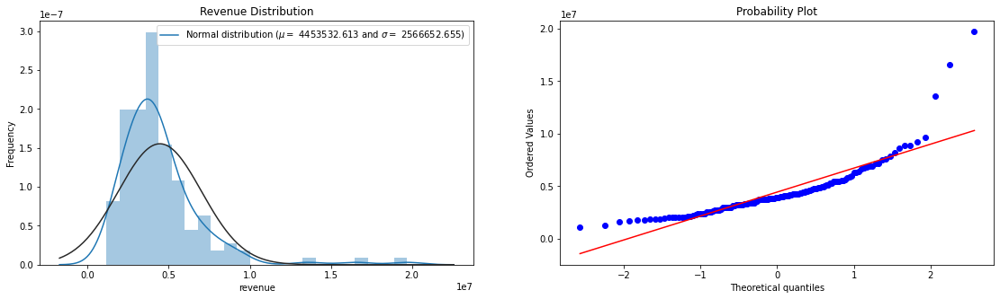

In [13]:
from scipy.stats import norm
from scipy import stats
(mu, sigma) = norm.fit(res['revenue'])
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(19, 5))
ax1 = sns.distplot(res['revenue'] , fit=norm, ax=ax1)
ax1.legend([f'Normal distribution ($\mu=$ {mu:.3f} and $\sigma=$ {sigma:.3f})'], loc='best')
ax1.set_ylabel('Frequency')
ax1.set_title('Revenue Distribution')
ax2 = stats.probplot(res['revenue'], plot=plt)
f.show();

/Users/namanvasudeva/miniforge3/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/var/folders/xn/st8_4ck924j2fd7h0smg9g440000gn/T/ipykernel_34807/3349097149.py:9: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  f.show();


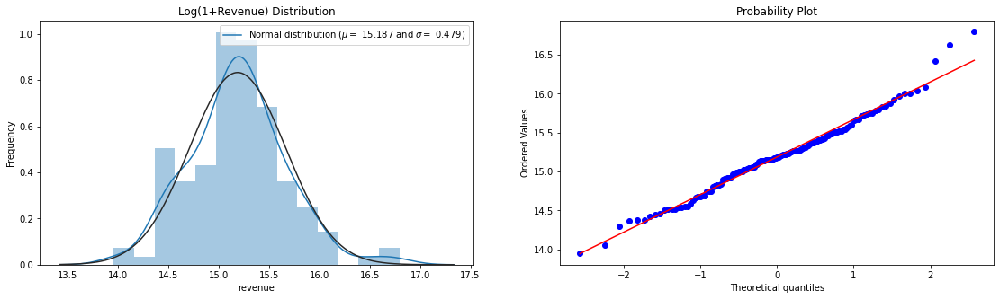

In [14]:
# Remember to use expm1 on predictions to transform back to dollar amount
(mu, sigma) = norm.fit(np.log1p(res['revenue']))
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(19, 5))
ax1 = sns.distplot(np.log1p(res['revenue']) , fit=norm, ax=ax1)
ax1.legend([f'Normal distribution ($\mu=$ {mu:.3f} and $\sigma=$ {sigma:.3f})'], loc='best')
ax1.set_ylabel('Frequency')
ax1.set_title('Log(1+Revenue) Distribution')
ax2 = stats.probplot(np.log(res['revenue']), plot=plt)
f.show();

In [15]:
#To get names of numerical features
numeric = [col for col in res.columns[2:] if res[col].dtypes!='object']
print('numeric columns are:',numeric)

numeric columns are: ['P1', 'P2', 'P3', 'P4', 'P5', 'P6', 'P7', 'P8', 'P9', 'P10', 'P11', 'P12', 'P13', 'P14', 'P15', 'P16', 'P17', 'P18', 'P19', 'P20', 'P21', 'P22', 'P23', 'P24', 'P25', 'P26', 'P27', 'P28', 'P29', 'P30', 'P31', 'P32', 'P33', 'P34', 'P35', 'P36', 'P37', 'revenue']


<AxesSubplot:xlabel='P1', ylabel='revenue'>

<AxesSubplot:xlabel='P2', ylabel='revenue'>

<AxesSubplot:xlabel='P3', ylabel='revenue'>

<AxesSubplot:xlabel='P4', ylabel='revenue'>

<AxesSubplot:xlabel='P5', ylabel='revenue'>

<AxesSubplot:xlabel='P6', ylabel='revenue'>

<AxesSubplot:xlabel='P7', ylabel='revenue'>

<AxesSubplot:xlabel='P8', ylabel='revenue'>

<AxesSubplot:xlabel='P9', ylabel='revenue'>

<AxesSubplot:xlabel='P10', ylabel='revenue'>

<AxesSubplot:xlabel='P11', ylabel='revenue'>

<AxesSubplot:xlabel='P12', ylabel='revenue'>

<AxesSubplot:xlabel='P13', ylabel='revenue'>

<AxesSubplot:xlabel='P14', ylabel='revenue'>

<AxesSubplot:xlabel='P15', ylabel='revenue'>

<AxesSubplot:xlabel='P16', ylabel='revenue'>

<AxesSubplot:xlabel='P17', ylabel='revenue'>

<AxesSubplot:xlabel='P18', ylabel='revenue'>

<AxesSubplot:xlabel='P19', ylabel='revenue'>

<AxesSubplot:xlabel='P20', ylabel='revenue'>

<AxesSubplot:xlabel='P21', ylabel='revenue'>

<AxesSubplot:xlabel='P22', ylabel='revenue'>

<AxesSubplot:xlabel='P23', ylabel='revenue'>

<AxesSubplot:xlabel='P24', ylabel='revenue'>

<AxesSubplot:xlabel='P25', ylabel='revenue'>

<AxesSubplot:xlabel='P26', ylabel='revenue'>

<AxesSubplot:xlabel='P27', ylabel='revenue'>

<AxesSubplot:xlabel='P28', ylabel='revenue'>

<AxesSubplot:xlabel='P29', ylabel='revenue'>

<AxesSubplot:xlabel='P30', ylabel='revenue'>

<AxesSubplot:xlabel='P31', ylabel='revenue'>

<AxesSubplot:xlabel='P32', ylabel='revenue'>

<AxesSubplot:xlabel='P33', ylabel='revenue'>

<AxesSubplot:xlabel='P34', ylabel='revenue'>

<AxesSubplot:xlabel='P35', ylabel='revenue'>

<AxesSubplot:xlabel='P36', ylabel='revenue'>

<AxesSubplot:xlabel='P37', ylabel='revenue'>

<AxesSubplot:xlabel='revenue', ylabel='revenue'>

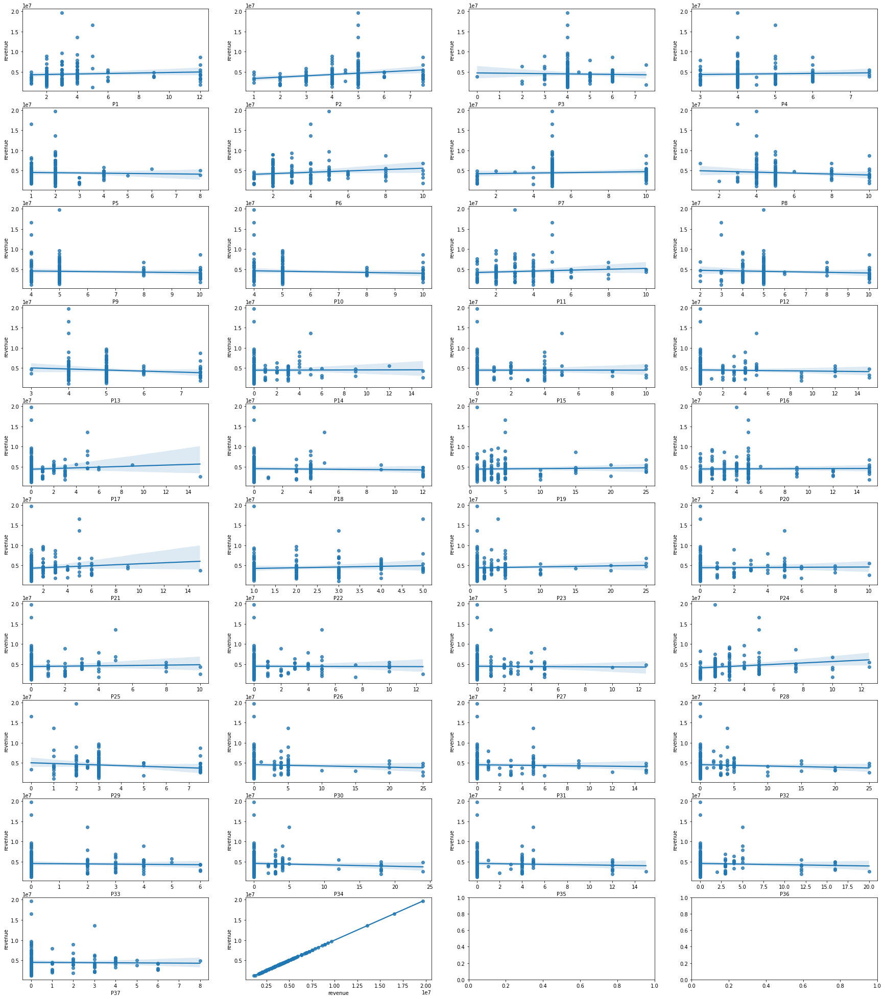

In [16]:
#Analyzing Relationships Between Numerical Variables and the target variable
fig, ax = plt.subplots(10, 4, figsize=(30, 35))
for variable, subplot in zip(numeric, ax.flatten()):
    sns.regplot(x=res[variable], y=res['revenue'], ax=subplot)

<AxesSubplot:xlabel='revenue', ylabel='City'>

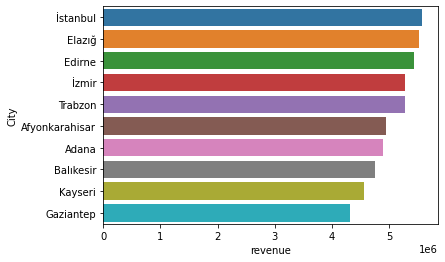

In [17]:
cityPerc = res[['City','revenue']].groupby(['City'],as_index=False).mean()
newDF = cityPerc.sort_values(['revenue'],ascending= False)
sns.barplot(x='revenue', y='City', data=newDF.head(10))

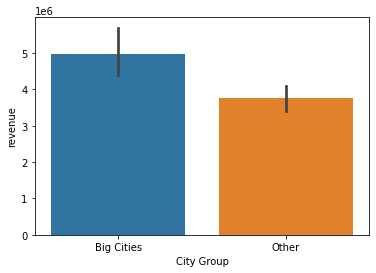

In [18]:
#Plotting revenue sum according to city type
import seaborn as sns
import matplotlib.pyplot as plt
df = sns.load_dataset('tips')
_=sns.barplot(x = 'City Group',y = 'revenue',data = res)
plt.show()

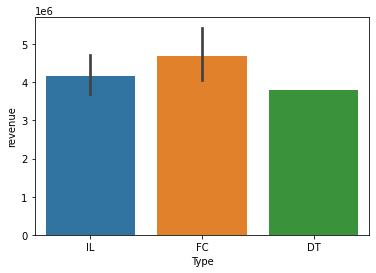

In [19]:
#Plotting revenue sum according to restraunt type
import seaborn as sns
import matplotlib.pyplot as plt
df = sns.load_dataset('tips')
sns.barplot(x = 'Type',y = 'revenue',data = res)
plt.show();

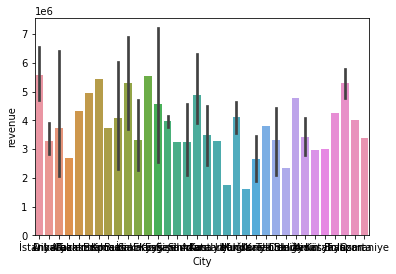

0      5653753
1      6923131
2      2055379
3      2675511
4      4316715
        ...   
132    5787594
133    9262754
134    2544857
135    7217634
136    6363241
Name: revenue, Length: 137, dtype: int64


In [20]:
#Plotting revenue sum according to restraunt type
import seaborn as sns
import matplotlib.pyplot as plt
df = sns.load_dataset('tips')
_=sns.barplot(x = 'City',y = 'revenue',data = res)
plt.show()
print(res["revenue"])

<AxesSubplot:>

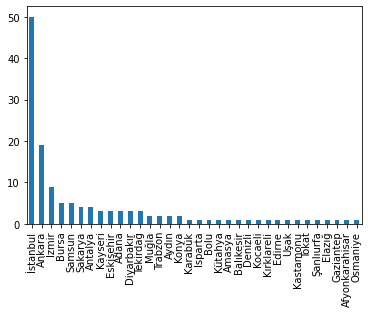

İstanbul          50
Ankara            19
İzmir              9
Bursa              5
Samsun             5
Sakarya            4
Antalya            4
Kayseri            3
Eskişehir          3
Adana              3
Diyarbakır         3
Tekirdağ           3
Muğla              2
Trabzon            2
Aydın              2
Konya              2
Karabük            1
Isparta            1
Bolu               1
Kütahya            1
Amasya             1
Balıkesir          1
Denizli            1
Kocaeli            1
Kırklareli         1
Edirne             1
Uşak               1
Kastamonu          1
Tokat              1
Şanlıurfa          1
Elazığ             1
Gaziantep          1
Afyonkarahisar     1
Osmaniye           1
Name: City, dtype: int64


In [21]:
# Plot for cities appearing in the test dataset
res["City"].value_counts().plot(kind='bar')
plt.show()
print(res["City"].value_counts())

<AxesSubplot:>

(0.0, 0.225193468477286)

<AxesSubplot:>

(0.0, 0.34402068027977123)

<AxesSubplot:>

(0.0, 0.6760947869992877)

<AxesSubplot:>

(0.0, 0.5968192919061784)

<AxesSubplot:>

(0.0, 0.4892945591440844)

<AxesSubplot:>

(0.0, 0.2835119234869267)

<AxesSubplot:>

(0.0, 0.35829212933236404)

<AxesSubplot:>

(0.0, 0.3637332943889668)

<AxesSubplot:>

(0.0, 0.41055729043750455)

<AxesSubplot:>

(0.0, 0.41673228344539665)

<AxesSubplot:>

(0.0, 0.2429083941988274)

<AxesSubplot:>

(0.0, 0.3722814957025585)

<AxesSubplot:>

(0.0, 0.6425772508539468)

<AxesSubplot:>

(0.0, 0.28522341717134375)

<AxesSubplot:>

(0.0, 0.3171726156398548)

<AxesSubplot:>

(0.0, 0.21603425451586267)

<AxesSubplot:>

(0.0, 0.3851077816245276)

<AxesSubplot:>

(0.0, 0.22311509959619072)

<AxesSubplot:>

(0.0, 0.1351753574164005)

<AxesSubplot:>

(0.0, 0.1514247608110898)

<AxesSubplot:>

(0.0, 0.3408700832077473)

<AxesSubplot:>

(0.0, 0.3574772593027448)

<AxesSubplot:>

(0.0, 0.16740904751669194)

<AxesSubplot:>

(0.0, 0.3299075317227688)

<AxesSubplot:>

(0.0, 0.3559335348767557)

<AxesSubplot:>

(0.0, 0.29408758702620735)

<AxesSubplot:>

(0.0, 0.3749715912867543)

<AxesSubplot:>

(0.0, 0.2651510464544389)

<AxesSubplot:>

(0.0, 0.439818724747757)

<AxesSubplot:>

(0.0, 0.13930535964684734)

<AxesSubplot:>

(0.0, 0.22039904347650258)

<AxesSubplot:>

(0.0, 0.15230133292072884)

<AxesSubplot:>

(0.0, 0.42441645540061534)

<AxesSubplot:>

(0.0, 0.15603961860571883)

<AxesSubplot:>

(0.0, 0.214571492738104)

<AxesSubplot:>

(0.0, 0.1817233005310529)

<AxesSubplot:>

(0.0, 0.4150018251348505)

<AxesSubplot:>

(0.0, 2.2362589580815184e-07)

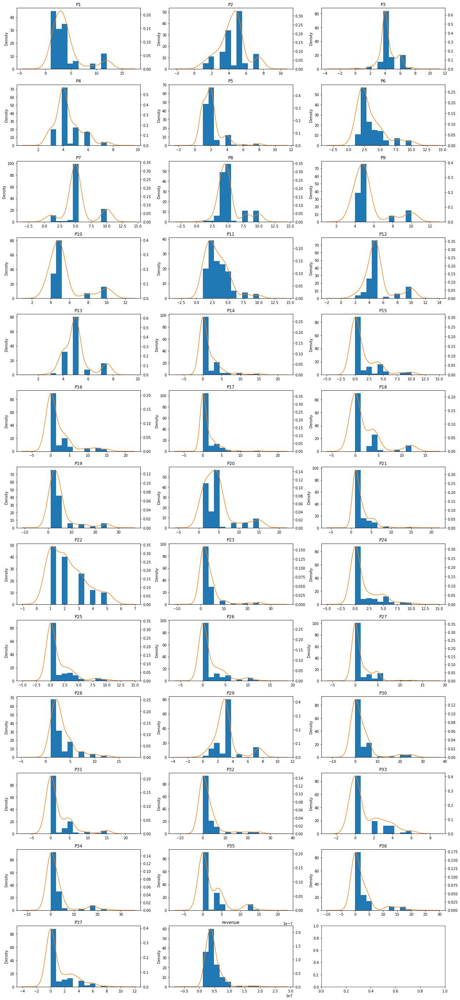

In [22]:
n = len(res[numeric].columns)
w = 3
h = (n - 1) // w + 1
_=fig, axes = plt.subplots(h, w, figsize=(w * 6, h * 3))
for i, (name, col) in enumerate(res[numeric].items()):
    r, c = i // w, i % w
    ax = axes[r, c]
    col.hist(ax=ax)
    ax2 = col.plot.kde(ax=ax, secondary_y=True, title=name)
    ax2.set_ylim(0)

_=fig.tight_layout()

In [23]:
#To get names of categorical features
categorical = [col for col in res.columns if res[col].dtypes=='object']
print('categorical columns are:',categorical)

categorical columns are: ['Open Date', 'City', 'City Group', 'Type']


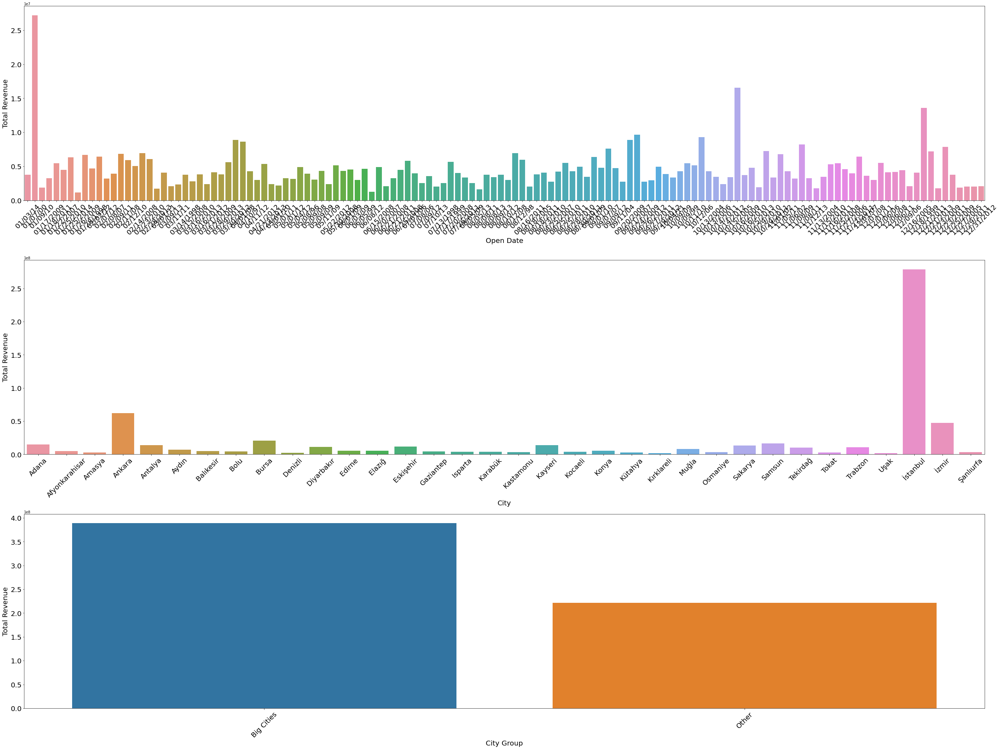

In [24]:
_=fig, ax = plt.subplots(3, 1, figsize=(40, 30))
for variable, subplot in zip(categorical, ax.flatten()):
    df_2 = res[[variable,'revenue']].groupby(variable).revenue.sum().reset_index()
    df_2.columns = [variable,'total_revenue']
    _=sns.barplot(x=variable, y='total_revenue', data=df_2 , ax=subplot)
    _=subplot.set_xlabel(variable,fontsize=20)
    _=subplot.set_ylabel('Total Revenue',fontsize=20)
    for label in subplot.get_xticklabels():
        label.set_rotation(45)
        label.set_size(20)
    for label in subplot.get_yticklabels():
        label.set_size(20)
_=fig.tight_layout()

<AxesSubplot:xlabel='P1', ylabel='revenue'>

Text(0.5, 0, 'P1')

Text(0, 0.5, 'Revenue')

<AxesSubplot:xlabel='P2', ylabel='revenue'>

Text(0.5, 0, 'P2')

Text(0, 0.5, 'Revenue')

<AxesSubplot:xlabel='P3', ylabel='revenue'>

Text(0.5, 0, 'P3')

Text(0, 0.5, 'Revenue')

<AxesSubplot:xlabel='P4', ylabel='revenue'>

Text(0.5, 0, 'P4')

Text(0, 0.5, 'Revenue')

<AxesSubplot:xlabel='P5', ylabel='revenue'>

Text(0.5, 0, 'P5')

Text(0, 0.5, 'Revenue')

<AxesSubplot:xlabel='P6', ylabel='revenue'>

Text(0.5, 0, 'P6')

Text(0, 0.5, 'Revenue')

<AxesSubplot:xlabel='P7', ylabel='revenue'>

Text(0.5, 0, 'P7')

Text(0, 0.5, 'Revenue')

<AxesSubplot:xlabel='P8', ylabel='revenue'>

Text(0.5, 0, 'P8')

Text(0, 0.5, 'Revenue')

<AxesSubplot:xlabel='P9', ylabel='revenue'>

Text(0.5, 0, 'P9')

Text(0, 0.5, 'Revenue')

<AxesSubplot:xlabel='P10', ylabel='revenue'>

Text(0.5, 0, 'P10')

Text(0, 0.5, 'Revenue')

<AxesSubplot:xlabel='P11', ylabel='revenue'>

Text(0.5, 0, 'P11')

Text(0, 0.5, 'Revenue')

<AxesSubplot:xlabel='P12', ylabel='revenue'>

Text(0.5, 0, 'P12')

Text(0, 0.5, 'Revenue')

<AxesSubplot:xlabel='P13', ylabel='revenue'>

Text(0.5, 0, 'P13')

Text(0, 0.5, 'Revenue')

<AxesSubplot:xlabel='P14', ylabel='revenue'>

Text(0.5, 0, 'P14')

Text(0, 0.5, 'Revenue')

<AxesSubplot:xlabel='P15', ylabel='revenue'>

Text(0.5, 0, 'P15')

Text(0, 0.5, 'Revenue')

<AxesSubplot:xlabel='P16', ylabel='revenue'>

Text(0.5, 0, 'P16')

Text(0, 0.5, 'Revenue')

<AxesSubplot:xlabel='P17', ylabel='revenue'>

Text(0.5, 0, 'P17')

Text(0, 0.5, 'Revenue')

<AxesSubplot:xlabel='P18', ylabel='revenue'>

Text(0.5, 0, 'P18')

Text(0, 0.5, 'Revenue')

<AxesSubplot:xlabel='P19', ylabel='revenue'>

Text(0.5, 0, 'P19')

Text(0, 0.5, 'Revenue')

<AxesSubplot:xlabel='P20', ylabel='revenue'>

Text(0.5, 0, 'P20')

Text(0, 0.5, 'Revenue')

<AxesSubplot:xlabel='P21', ylabel='revenue'>

Text(0.5, 0, 'P21')

Text(0, 0.5, 'Revenue')

<AxesSubplot:xlabel='P22', ylabel='revenue'>

Text(0.5, 0, 'P22')

Text(0, 0.5, 'Revenue')

<AxesSubplot:xlabel='P23', ylabel='revenue'>

Text(0.5, 0, 'P23')

Text(0, 0.5, 'Revenue')

<AxesSubplot:xlabel='P24', ylabel='revenue'>

Text(0.5, 0, 'P24')

Text(0, 0.5, 'Revenue')

<AxesSubplot:xlabel='P25', ylabel='revenue'>

Text(0.5, 0, 'P25')

Text(0, 0.5, 'Revenue')

<AxesSubplot:xlabel='P26', ylabel='revenue'>

Text(0.5, 0, 'P26')

Text(0, 0.5, 'Revenue')

<AxesSubplot:xlabel='P27', ylabel='revenue'>

Text(0.5, 0, 'P27')

Text(0, 0.5, 'Revenue')

<AxesSubplot:xlabel='P28', ylabel='revenue'>

Text(0.5, 0, 'P28')

Text(0, 0.5, 'Revenue')

<AxesSubplot:xlabel='P29', ylabel='revenue'>

Text(0.5, 0, 'P29')

Text(0, 0.5, 'Revenue')

<AxesSubplot:xlabel='P30', ylabel='revenue'>

Text(0.5, 0, 'P30')

Text(0, 0.5, 'Revenue')

<AxesSubplot:xlabel='P31', ylabel='revenue'>

Text(0.5, 0, 'P31')

Text(0, 0.5, 'Revenue')

<AxesSubplot:xlabel='P32', ylabel='revenue'>

Text(0.5, 0, 'P32')

Text(0, 0.5, 'Revenue')

<AxesSubplot:xlabel='P33', ylabel='revenue'>

Text(0.5, 0, 'P33')

Text(0, 0.5, 'Revenue')

<AxesSubplot:xlabel='P34', ylabel='revenue'>

Text(0.5, 0, 'P34')

Text(0, 0.5, 'Revenue')

<AxesSubplot:xlabel='P35', ylabel='revenue'>

Text(0.5, 0, 'P35')

Text(0, 0.5, 'Revenue')

<AxesSubplot:xlabel='P36', ylabel='revenue'>

Text(0.5, 0, 'P36')

Text(0, 0.5, 'Revenue')

<AxesSubplot:xlabel='P37', ylabel='revenue'>

Text(0.5, 0, 'P37')

Text(0, 0.5, 'Revenue')

<AxesSubplot:xlabel='revenue', ylabel='revenue'>

Text(0.5, 0, 'revenue')

Text(0, 0.5, 'Revenue')

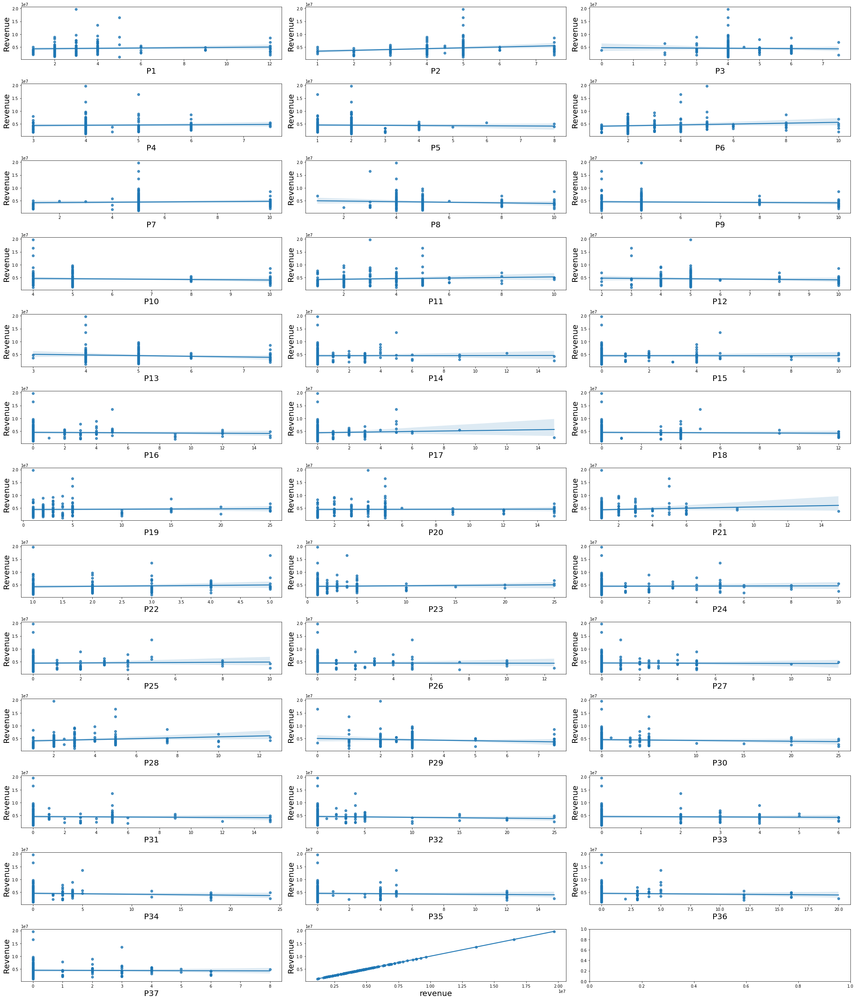

In [25]:
fig, ax = plt.subplots(13, 3, figsize=(30, 35))
for variable, subplot in zip(numeric, ax.flatten()):
    sns.regplot(x=res[variable], y=res['revenue'], ax=subplot)
    subplot.set_xlabel(variable,fontsize=20)
    subplot.set_ylabel('Revenue',fontsize=20)
fig.tight_layout()

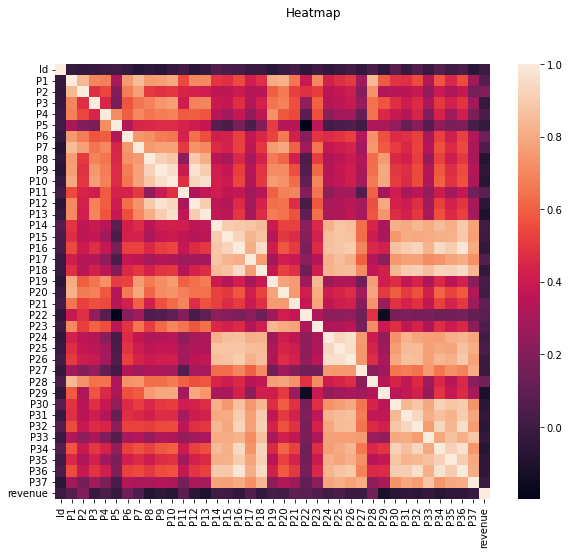

In [26]:
# Correlation features with revenue
plt.figure(figsize=(10, 8))
sns.heatmap(res.corr(), square=True)
plt.suptitle('Heatmap')
plt.show();

# Feature Engineering

In [27]:
##DROP R ENTER AND CUST ID
#RENTER IS ALWAYS 1 AND CUST ID IS NOT REQUIRED
res=res.drop(['Id'],axis=1)


In [28]:
#adjust the date
import datetime
res['Open Date']  = pd.to_datetime(res['Open Date'])
launch_date = datetime.datetime(2015, 3, 23)
# scale days open
res['Days Open'] = (launch_date - res['Open Date']).dt.days / 1000
res.drop('Open Date', axis=1, inplace=True)


In [29]:
#One hot encoding 
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import OneHotEncoder

In [30]:
le=LabelEncoder()

In [31]:
res['City']=le.fit_transform(res['City'])
res['City Group']=le.fit_transform(res['City Group'])
res['Type']=le.fit_transform(res['Type'])
res['P1']=le.fit_transform(res['P1'])
res['P2']=le.fit_transform(res['P2'])
res['P3']=le.fit_transform(res['P3'])
res['P4']=le.fit_transform(res['P4'])
res['P5']=le.fit_transform(res['P5'])
res['P6']=le.fit_transform(res['P6'])
res['P7']=le.fit_transform(res['P7'])
res['P8']=le.fit_transform(res['P8'])
res['P9']=le.fit_transform(res['P9'])
res['P10']=le.fit_transform(res['P10'])
res['P11']=le.fit_transform(res['P11'])
res['P12']=le.fit_transform(res['P12'])
res['P13']=le.fit_transform(res['P13'])
res['P14']=le.fit_transform(res['P14'])
res['P15']=le.fit_transform(res['P15'])
res['P16']=le.fit_transform(res['P16'])
res['P17']=le.fit_transform(res['P17'])
res['P18']=le.fit_transform(res['P18'])
res['P19']=le.fit_transform(res['P19'])
res['P20']=le.fit_transform(res['P20'])
res['P21']=le.fit_transform(res['P21'])
res['P22']=le.fit_transform(res['P22'])
res['P23']=le.fit_transform(res['P23'])
res['P24']=le.fit_transform(res['P24'])
res['P25']=le.fit_transform(res['P25'])
res['P26']=le.fit_transform(res['P26'])
res['P27']=le.fit_transform(res['P27'])
res['P28']=le.fit_transform(res['P28'])
res['P29']=le.fit_transform(res['P29'])
res['P30']=le.fit_transform(res['P30'])
res['P31']=le.fit_transform(res['P31'])
res['P32']=le.fit_transform(res['P32'])
res['P33']=le.fit_transform(res['P33'])
res['P34']=le.fit_transform(res['P34'])
res['P35']=le.fit_transform(res['P35'])
res['P36']=le.fit_transform(res['P36'])
res['P37']=le.fit_transform(res['P37'])

In [32]:
res['revenue'] = res['revenue'].astype(int)

# Finding Structure in Data

In [33]:
# 3.0 Select only numeric columns for the purpose
num_data = res.select_dtypes(include = ['float64', 'int64']).copy()
num_data.head()
num_data.shape       # (137,38)
num_data.columns

,City,City Group,Type,P1,P2,P3,P4,P5,P6,P7,...,P30,P31,P32,P33,P34,P35,P36,P37,revenue,Days Open
0,31,0,2,3,5,3,1,1,1,4,...,4,3,4,4,4,4,2,4,5653753,5.728
1,3,0,1,3,5,3,1,0,1,4,...,0,0,0,0,0,0,0,0,6923131,2.594
2,10,1,2,1,3,1,3,1,2,4,...,0,0,0,0,0,0,0,0,2055379,0.744
3,28,1,2,5,4,6,4,3,3,5,...,8,8,6,5,6,6,5,6,2675511,1.145
4,14,1,2,2,3,2,1,1,1,4,...,4,1,3,1,2,4,2,3,4316715,2.144


(137, 42)

Index(['City', 'City Group', 'Type', 'P1', 'P2', 'P3', 'P4', 'P5', 'P6', 'P7',
       'P8', 'P9', 'P10', 'P11', 'P12', 'P13', 'P14', 'P15', 'P16', 'P17',
       'P18', 'P19', 'P20', 'P21', 'P22', 'P23', 'P24', 'P25', 'P26', 'P27',
       'P28', 'P29', 'P30', 'P31', 'P32', 'P33', 'P34', 'P35', 'P36', 'P37',
       'revenue', 'Days Open'],
      dtype='object')

In [34]:
# 3.1 Columns in num_data that are either discrete (with few levels)
#     or numeric

cols=['City', 'City Group', 'Type', 'P1', 'P2', 'P3', 'P4', 'P5', 'P6', 'P7',
       'P8', 'P9', 'P10', 'P11', 'P12', 'P13', 'P14', 'P15', 'P16', 'P17',
       'P18', 'P19', 'P20', 'P21', 'P22', 'P23', 'P24', 'P25', 'P26', 'P27',
       'P28', 'P29', 'P30', 'P31', 'P32', 'P33', 'P34', 'P35', 'P36', 'P37',
       'revenue', 'Days Open']##CAN DIVIDE INCOME INTO CATEGORIES AND RUN AS CATEGORICAL.

In [35]:
cat_data=['City', 'City Group', 'Type', 'P1', 'P2', 'P3', 'P4', 'P5', 'P6', 'P7',
       'P8', 'P9', 'P10', 'P11', 'P12', 'P13', 'P14', 'P15', 'P16', 'P17',
       'P18', 'P19', 'P20', 'P21', 'P22', 'P23', 'P24', 'P25', 'P26', 'P27',
       'P28', 'P29', 'P30', 'P31', 'P32', 'P33', 'P34', 'P35', 'P36', 'P37']

In [36]:
num_data=['revenue', 'Days Open']

In [37]:
# 3.2 Create an instance of StandardScaler object
ss= StandardScaler()

In [39]:
res.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 137 entries, 0 to 136
Data columns (total 42 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   City        137 non-null    int64  
 1   City Group  137 non-null    int64  
 2   Type        137 non-null    int64  
 3   P1          137 non-null    int64  
 4   P2          137 non-null    int64  
 5   P3          137 non-null    int64  
 6   P4          137 non-null    int64  
 7   P5          137 non-null    int64  
 8   P6          137 non-null    int64  
 9   P7          137 non-null    int64  
 10  P8          137 non-null    int64  
 11  P9          137 non-null    int64  
 12  P10         137 non-null    int64  
 13  P11         137 non-null    int64  
 14  P12         137 non-null    int64  
 15  P13         137 non-null    int64  
 16  P14         137 non-null    int64  
 17  P15         137 non-null    int64  
 18  P16         137 non-null    int64  
 19  P17         137 non-null    i

In [41]:

res.head()


,City,City Group,Type,P1,P2,P3,P4,P5,P6,P7,...,P30,P31,P32,P33,P34,P35,P36,P37,revenue,Days Open
0,31,0,2,3,5,3,1,1,1,4,...,4,3,4,4,4,4,2,4,5653753,5.728
1,3,0,1,3,5,3,1,0,1,4,...,0,0,0,0,0,0,0,0,6923131,2.594
2,10,1,2,1,3,1,3,1,2,4,...,0,0,0,0,0,0,0,0,2055379,0.744
3,28,1,2,5,4,6,4,3,3,5,...,8,8,6,5,6,6,5,6,2675511,1.145
4,14,1,2,2,3,2,1,1,1,4,...,4,1,3,1,2,4,2,3,4316715,2.144


In [122]:
#dropping city, city group and type to check the p compoenent correlation
res2 = res.drop(res.columns[[0,1,2,40]] , axis=1)

In [45]:
#setting target variable
y = res2["revenue"]

In [123]:
res2.head()

,P1,P2,P3,P4,P5,P6,P7,P8,P9,P10,...,P29,P30,P31,P32,P33,P34,P35,P36,P37,Days Open
0,3,5,3,1,1,1,4,3,1,1,...,4,4,3,4,4,4,4,2,4,5.728
1,3,5,3,1,0,1,4,4,1,1,...,4,0,0,0,0,0,0,0,0,2.594
2,1,3,1,3,1,2,4,4,1,1,...,4,0,0,0,0,0,0,0,0,0.744
3,5,4,6,4,3,3,5,6,3,3,...,6,8,8,6,5,6,6,5,6,1.145
4,2,3,2,1,1,1,4,4,1,1,...,4,4,1,3,1,2,4,2,3,2.144


In [124]:
#importing standard scaler
from sklearn.preprocessing import StandardScaler

sc = StandardScaler()

In [125]:
# get numeric data
num_d = res2.select_dtypes(exclude=['object','category'])

# update the cols with their normalized values
res2[num_d.columns] = sc.fit_transform(num_d)

In [126]:
res2.head()

,P1,P2,P3,P4,P5,P6,P7,P8,P9,P10,...,P29,P30,P31,P32,P33,P34,P35,P36,P37,Days Open
0,0.208266,0.614194,-0.435383,-0.489135,0.006422,-0.683287,0.177961,-0.687998,0.000000,-0.041725,...,0.301271,1.131807,0.519634,0.937450,2.520617,1.511250,1.086582,0.453198,1.644301,2.412027
1,0.208266,0.614194,-0.435383,-0.489135,-0.873375,-0.683287,0.177961,0.066048,0.000000,-0.041725,...,0.301271,-0.660766,-0.634796,-0.657962,-0.611578,-0.623196,-0.706933,-0.645707,-0.631146,0.274059
2,-0.848492,-0.478593,-1.890197,0.951973,0.006422,-0.129380,0.177961,0.066048,0.000000,-0.041725,...,0.301271,-0.660766,-0.634796,-0.657962,-0.611578,-0.623196,-0.706933,-0.645707,-0.631146,-0.987983
3,1.265024,0.067801,1.746840,1.672526,1.766016,0.424528,0.990649,1.574140,2.273722,2.244787,...,1.749487,2.924381,2.443685,1.735155,3.303666,2.578473,1.983339,2.101555,2.782024,-0.714427
4,-0.320113,-0.478593,-1.162790,-0.489135,0.006422,-0.683287,0.177961,0.066048,0.000000,-0.041725,...,0.301271,1.131807,-0.249986,0.538597,0.171471,0.444027,1.086582,0.453198,1.075439,-0.032924


In [127]:
y = pd.DataFrame(y)

In [128]:
y

,revenue
0,5653753
1,6923131
2,2055379
3,2675511
4,4316715
...,...
132,5787594
133,9262754
134,2544857
135,7217634


# Pipeline


In [58]:
from sklearn.impute import SimpleImputer

# 1.4 One hot encode categorical data--Convert to dummy
# https://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.OneHotEncoder.html
from sklearn.preprocessing import OneHotEncoder as onehot

# 1.5 Scale numeric data
from sklearn.preprocessing import StandardScaler as ss

## C. Transformer for target:

# 1.6 Label encode target column
from sklearn.preprocessing import LabelEncoder

## D. Composite Transformers:

# 1.7 Class for applying multiple data transformation
#     jobs parallely
from sklearn.compose import ColumnTransformer

# 1.8 Pipeline class: Class for applying multiple
#     data transformations sequentially
from sklearn.pipeline import Pipeline

## E. Estimator

# 1.9 Estimator
# Ref: https://scikit-learn.org/stable/modules/generated/sklearn.tree.DecisionTreeClassifier.html
# User guide: https://scikit-learn.org/stable/modules/tree.html
from sklearn.tree import DecisionTreeClassifier 

# 1.10 To plot graphs and pipeline diagram
import matplotlib.pyplot as plt
import plotly.express as px
import seaborn as sns
from sklearn import set_config

In [59]:
# 1.11 Display outputs of all commands from a cell--not just of the last command
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

In [60]:
# 2.0 Import warnings module
#     No FutureWarnings display
 
import warnings
# 2.1 Do not print warnings on screen
warnings.filterwarnings("ignore")

In [61]:
num_cols=cols

In [62]:
#num_pipe
from sklearn.impute import SimpleImputer
Pipe = Pipeline(steps=[('simp_imputer',SimpleImputer(strategy='median')),  ('stand_scale',StandardScaler())])
#imputer = imputer.fit(df[['B']])
#df['B'] = imputer.transform(df[['B']])]
#df

In [63]:
Pipe.fit_transform(res[num_cols])

array([[ 0.88075847, -0.86971849,  1.11702464, ...,  1.6443005 ,
         0.46762089,  2.41202674],
       [-1.49685552, -0.86971849, -0.8449289 , ..., -0.63114565,
         0.96218644,  0.27405909],
       [-0.90245203,  1.14979733,  1.11702464, ..., -0.63114565,
        -0.93435066, -0.98798308],
       ...,
       [-0.22313374,  1.14979733, -0.8449289 , ..., -0.63114565,
        -0.74364391,  0.67381948],
       [ 0.88075847, -0.86971849, -0.8449289 , ..., -0.63114565,
         1.0769285 , -0.39993964],
       [ 0.88075847, -0.86971849, -0.8449289 , ..., -0.63114565,
         0.74404629, -0.11137541]])

In [66]:
from xgboost import XGBRegressor

In [67]:
################# CC. Create pipeline #################
#### Pipe using XGBoost




steps_xg = [('sts', ss() ),
            ('pca', PCA()),
            ('xg',  XGBRegressor())        # Specify other parameters here
            
            ]


In [68]:
pipe_xg = Pipeline(steps_xg)


In [105]:
res2

,Type,P1,P2,P3,P4,P5,P6,P7,P8,P9,...,P29,P30,P31,P32,P33,P34,P35,P36,P37,Days Open
0,1.117025,0.208266,0.614194,-0.435383,-0.489135,0.006422,-0.683287,0.177961,-0.687998,0.000000,...,0.301271,1.131807,0.519634,0.937450,2.520617,1.511250,1.086582,0.453198,1.644301,2.412027
1,-0.844929,0.208266,0.614194,-0.435383,-0.489135,-0.873375,-0.683287,0.177961,0.066048,0.000000,...,0.301271,-0.660766,-0.634796,-0.657962,-0.611578,-0.623196,-0.706933,-0.645707,-0.631146,0.274059
2,1.117025,-0.848492,-0.478593,-1.890197,0.951973,0.006422,-0.129380,0.177961,0.066048,0.000000,...,0.301271,-0.660766,-0.634796,-0.657962,-0.611578,-0.623196,-0.706933,-0.645707,-0.631146,-0.987983
3,1.117025,1.265024,0.067801,1.746840,1.672526,1.766016,0.424528,0.990649,1.574140,2.273722,...,1.749487,2.924381,2.443685,1.735155,3.303666,2.578473,1.983339,2.101555,2.782024,-0.714427
4,1.117025,-0.320113,-0.478593,-1.162790,-0.489135,0.006422,-0.683287,0.177961,0.066048,0.000000,...,0.301271,1.131807,-0.249986,0.538597,0.171471,0.444027,1.086582,0.453198,1.075439,-0.032924
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
132,-0.844929,-0.848492,-1.024987,-1.162790,0.951973,1.766016,-0.683287,-0.634727,-0.687998,-1.136861,...,0.301271,-0.660766,-0.634796,-0.657962,-0.611578,-0.623196,-0.706933,-0.645707,-0.631146,0.184011
133,-0.844929,0.208266,0.614194,-0.435383,-0.489135,0.006422,-0.129380,0.177961,-0.687998,-1.136861,...,0.301271,-0.660766,-0.634796,-0.657962,-0.611578,-0.623196,-0.706933,-0.645707,-0.631146,0.608330
134,-0.844929,-0.320113,-0.478593,-0.435383,-0.489135,0.006422,-0.129380,0.177961,0.066048,0.000000,...,0.301271,-0.660766,-0.634796,-0.657962,-0.611578,-0.623196,-0.706933,-0.645707,-0.631146,0.673819
135,-0.844929,0.208266,0.614194,-0.435383,0.951973,0.006422,-0.683287,0.177961,0.066048,0.000000,...,0.301271,-0.660766,-0.634796,-0.657962,-0.611578,-0.623196,-0.706933,-0.645707,-0.631146,-0.399940


In [129]:
X2 = res2

In [130]:
from sklearn.model_selection import train_test_split

In [131]:
#performing train test split
X2_train, X_test, y2_train, y_test = train_test_split(X2,
                                                    y,
                                                    test_size=0.01,
                                                    shuffle = True,
                                                    
                                                    )


X2_train.shape
X_test.shape
y2_train.shape
y_test.shape

(135, 38)

(2, 38)

(135, 1)

(2, 1)

In [132]:
#defining pipe
pipe_xg = Pipeline(steps_xg)

In [133]:
#checking parameters
pipe_xg.get_params()

{'memory': None,
 'steps': [('sts', StandardScaler()),
  ('pca', PCA()),
  ('xg',
   XGBRegressor(base_score=None, booster=None, callbacks=None,
                colsample_bylevel=None, colsample_bynode=None,
                colsample_bytree=None, early_stopping_rounds=None,
                enable_categorical=False, eval_metric=None, gamma=None,
                gpu_id=None, grow_policy=None, importance_type=None,
                interaction_constraints=None, learning_rate=None, max_bin=None,
                max_cat_to_onehot=None, max_delta_step=None, max_depth=None,
                max_leaves=None, min_child_weight=None, missing=nan,
                monotone_constraints=None, n_estimators=100, n_jobs=None,
                num_parallel_tree=None, predictor=None, random_state=None,
                reg_alpha=None, reg_lambda=None, ...))],
 'verbose': False,
 'sts': StandardScaler(),
 'pca': PCA(),
 'xg': XGBRegressor(base_score=None, booster=None, callbacks=None,
              colsample_b

In [134]:
#Setting parameters
parameters = {'xg__learning_rate':  [0.03, 0.05], 
               'xg__max_depth':      [4,6],
              'pca__n_components' : [1,8]
               }               

In [135]:
#performing grid search
clf = GridSearchCV(pipe_xg,            # pipeline object
                   parameters,         # possible parameters
                   n_jobs = 2,         # USe parallel cpu threads
                   cv =2 ,             # No of folds
                   verbose =1,         # Higher the value, more the verbosity
                   scoring = ['accuracy', 'roc_auc'],  # Metrics for performance
                   refit = 'roc_auc'   # Refitting final model on what parameters?
                                       # Those which maximise auc
                   )

In [136]:
import time as time

In [137]:
print("\n\n--Takes time...---\n")
start = time.time()
clf.fit(X2_train, y2_train)
end = time.time()
print()
(end - start)/60 



--Takes time...---

Fitting 2 folds for each of 8 candidates, totalling 16 fits


/Users/namanvasudeva/miniforge3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:776: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/Users/namanvasudeva/miniforge3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/Users/namanvasudeva/miniforge3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 106, in __call__
    score = scorer._score(cached_call, estimator, *args, **kwargs)
  File "/Users/namanvasudeva/miniforge3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 267, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "/Users/namanvasudeva/miniforge3/lib/python3.9/site-packages/sklearn/metrics/_classification.py", line 211, in accuracy_score
    y_type, y_true, y_pred = _check_targets(y_true, y_pre

GridSearchCV(cv=2,
             estimator=Pipeline(steps=[('sts', StandardScaler()),
                                       ('pca', PCA()),
                                       ('xg',
                                        XGBRegressor(base_score=None,
                                                     booster=None,
                                                     callbacks=None,
                                                     colsample_bylevel=None,
                                                     colsample_bynode=None,
                                                     colsample_bytree=None,
                                                     early_stopping_rounds=None,
                                                     enable_categorical=False,
                                                     eval_metric=None,
                                                     gamma=None, gpu_id=None,
                                                     grow_policy=None,
                                                     importance_type=None,
                                                     interac...
                                                     max_leaves=None,
                                                     min_child_weight=None,
                                                     missing=nan,
                                                     monotone_constraints=None,
                                                     n_estimators=100,
                                                     n_jobs=None,
                                                     num_parallel_tree=None,
                                                     predictor=None,
                                                     random_state=None,
                                                     reg_alpha=None,
                                                     reg_lambda=None, ...))]),
             n_jobs=2,
             param_grid={'pca__n_components': [1, 8],
                         'xg__learning_rate': [0.03, 0.05],
                         'xg__max_depth': [4, 6]},
             refit='roc_auc', scoring=['accuracy', 'roc_auc'], verbose=1)

0.01777278184890747

In [138]:
#checking best parameters for predicting
f"Best parameter set {clf.best_params_}"

"Best parameter set {'pca__n_components': 1, 'xg__learning_rate': 0.03, 'xg__max_depth': 4}"

# Cross Validation


In [139]:
cv = RepeatedKFold(n_splits=10, n_repeats=3, random_state=1)

In [140]:
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import RepeatedKFold

In [141]:
scores = cross_val_score(pipe_xg, X2, y, scoring='neg_mean_absolute_error', cv=cv, n_jobs=-1)

In [142]:

from numpy import absolute

# PREDICTION

In [143]:
y_pred = clf.predict(X_test)
print("--Few predictions--\n")
y_pred[:4]

scores = absolute(scores)
print('Mean MAE: %.3f (%.3f)' % (scores.mean(), scores.std()) )

--Few predictions--



array([2733608.5, 4942406.5], dtype=float32)

Mean MAE: 1865219.840 (516015.870)


In [144]:

print("\n\n--How many features--\n")
clf.best_estimator_.named_steps["xg"].feature_importances_.shape

# 7.9.1
print("\n\n---Feature importances---\n")
clf.best_estimator_.named_steps["xg"].feature_importances_



--How many features--



(1,)



---Feature importances---



array([1.], dtype=float32)

In [147]:
colnames = X2.iloc[:,0:1].columns.tolist()

In [148]:
imp_values = clf.best_estimator_.named_steps["xg"].feature_importances_

df_imp = pd.DataFrame(
                      data = imp_values,
                      index = colnames,
                      columns = ["imp"]
                      ).sort_values(by = 'imp')

# 7.10.1
df_imp

,imp
P1,1.0


In [149]:
list(df_imp.index.values[:5])

['P1']

In [152]:
Xtrain = X2_train.drop(columns = list(df_imp.index.values[:5]))
Xtest = X_test.drop(columns = list(df_imp.index.values[:5]))

# 8.1 Build model again
clf_dr = GridSearchCV(pipe_xg,            # pipeline object
                      parameters,         # possible parameters
                      n_jobs = 2,         # USe parallel cpu threads
                      cv =3 ,             # No of folds
                      verbose =2,         # Higher the value, more the verbosity
                      scoring = ['accuracy', 'roc_auc'],  # Metrics for performance
                      refit = 'roc_auc'   # Refitting final model on what parameters?
                                       # Those which maximise auc
                     )

# 8.2
start = time.time()
clf_dr.fit(Xtrain, y2_train)
end = time.time()
(end - start)/60               # 25 minutes

# 8.3 Make predictions
y_pred_dr = clf_dr.predict(Xtest)


Fitting 3 folds for each of 8 candidates, totalling 24 fits


/Users/namanvasudeva/miniforge3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:776: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/Users/namanvasudeva/miniforge3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/Users/namanvasudeva/miniforge3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 106, in __call__
    score = scorer._score(cached_call, estimator, *args, **kwargs)
  File "/Users/namanvasudeva/miniforge3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 267, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "/Users/namanvasudeva/miniforge3/lib/python3.9/site-packages/sklearn/metrics/_classification.py", line 211, in accuracy_score
    y_type, y_true, y_pred = _check_targets(y_true, y_pre

/Users/namanvasudeva/miniforge3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:776: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/Users/namanvasudeva/miniforge3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/Users/namanvasudeva/miniforge3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 106, in __call__
    score = scorer._score(cached_call, estimator, *args, **kwargs)
  File "/Users/namanvasudeva/miniforge3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 267, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "/Users/namanvasudeva/miniforge3/lib/python3.9/site-packages/sklearn/metrics/_classification.py", line 211, in accuracy_score
    y_type, y_true, y_pred = _check_targets(y_true, y_pre

GridSearchCV(cv=3,
             estimator=Pipeline(steps=[('sts', StandardScaler()),
                                       ('pca', PCA()),
                                       ('xg',
                                        XGBRegressor(base_score=None,
                                                     booster=None,
                                                     callbacks=None,
                                                     colsample_bylevel=None,
                                                     colsample_bynode=None,
                                                     colsample_bytree=None,
                                                     early_stopping_rounds=None,
                                                     enable_categorical=False,
                                                     eval_metric=None,
                                                     gamma=None, gpu_id=None,
                                                     grow_policy=None,
                                                     importance_type=None,
                                                     interac...
                                                     max_leaves=None,
                                                     min_child_weight=None,
                                                     missing=nan,
                                                     monotone_constraints=None,
                                                     n_estimators=100,
                                                     n_jobs=None,
                                                     num_parallel_tree=None,
                                                     predictor=None,
                                                     random_state=None,
                                                     reg_alpha=None,
                                                     reg_lambda=None, ...))]),
             n_jobs=2,
             param_grid={'pca__n_components': [1, 8],
                         'xg__learning_rate': [0.03, 0.05],
                         'xg__max_depth': [4, 6]},
             refit='roc_auc', scoring=['accuracy', 'roc_auc'], verbose=2)

0.008569252490997315

In [154]:
parameters = {#uniform means decimals, range means int
              'xg__n_estimators':   range(50,300),
              'xg__max_depth':      range(3,10),
              'pca__n_components' : range(20,30)}

Random Search

In [155]:
rs = RandomizedSearchCV(
                          pipe_xg,
                          param_distributions=parameters,
                          scoring= ['roc_auc', 'accuracy'],
                          n_iter=4,           # Max combination of
                                              # parameter to try. Default = 10
                          verbose = 1,
                          refit = 'roc_auc',
                          n_jobs = 2,          # Use parallel cpu threads
                          cv = 2               # No of folds.
                                              # So n_iter * cv combinations
                        )


In [157]:
start = time.time()
rs.fit(X2_train, y2_train)
end = time.time()
print()
(end - start)/60 

Fitting 2 folds for each of 4 candidates, totalling 8 fits


/Users/namanvasudeva/miniforge3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:776: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/Users/namanvasudeva/miniforge3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/Users/namanvasudeva/miniforge3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 106, in __call__
    score = scorer._score(cached_call, estimator, *args, **kwargs)
  File "/Users/namanvasudeva/miniforge3/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 352, in _score
    raise ValueError("{0} format is not supported".format(y_type))
ValueError: multiclass format is not supported

  warnings.warn(
/Users/namanvasudeva/miniforge3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:776: UserWarning: Scoring failed

RandomizedSearchCV(cv=2,
                   estimator=Pipeline(steps=[('sts', StandardScaler()),
                                             ('pca', PCA()),
                                             ('xg',
                                              XGBRegressor(base_score=None,
                                                           booster=None,
                                                           callbacks=None,
                                                           colsample_bylevel=None,
                                                           colsample_bynode=None,
                                                           colsample_bytree=None,
                                                           early_stopping_rounds=None,
                                                           enable_categorical=False,
                                                           eval_metric=None,
                                                           gamma=None,
                                                           gpu_id=None,
                                                           grow_policy=None,
                                                           importance_type=None,
                                                           i...
                                                           missing=nan,
                                                           monotone_constraints=None,
                                                           n_estimators=100,
                                                           n_jobs=None,
                                                           num_parallel_tree=None,
                                                           predictor=None,
                                                           random_state=None,
                                                           reg_alpha=None,
                                                           reg_lambda=None, ...))]),
                   n_iter=4, n_jobs=2,
                   param_distributions={'pca__n_components': range(20, 30),
                                        'xg__max_depth': range(3, 10),
                                        'xg__n_estimators': range(50, 300)},
                   refit='roc_auc', scoring=['roc_auc', 'accuracy'], verbose=1)

0.009818585713704427

In [159]:
f"Best score: {rs.best_score_} " ;print()          
f"Best parameter set: {rs.best_params_} " ; print()


# 9.4 Make predictions from the best returned model
y_pred = rs.predict(X_test)



'Best score: nan '

"Best parameter set: {'xg__n_estimators': 284, 'xg__max_depth': 6, 'pca__n_components': 25} "

In [166]:
res_test=pd.read_csv('test 2.csv')

In [167]:
res_test.head()
print("\n-----\n")
res_test.dtypes
print("\n-----\n")
res_test.isnull().sum()

,Id,Open Date,City,City Group,Type,P1,P2,P3,P4,P5,...,P28,P29,P30,P31,P32,P33,P34,P35,P36,P37
0,0,01/22/2011,Niğde,Other,FC,1,4.0,4.0,4.0,1,...,2.0,3.0,0,0,0,0,0,0,0,0
1,1,03/18/2011,Konya,Other,IL,3,4.0,4.0,4.0,2,...,1.0,3.0,0,0,0,0,0,0,0,0
2,2,10/30/2013,Ankara,Big Cities,FC,3,4.0,4.0,4.0,2,...,2.0,3.0,0,0,0,0,0,0,0,0
3,3,05/06/2013,Kocaeli,Other,IL,2,4.0,4.0,4.0,2,...,2.0,3.0,0,4,0,0,0,0,0,0
4,4,07/31/2013,Afyonkarahisar,Other,FC,2,4.0,4.0,4.0,1,...,5.0,3.0,0,0,0,0,0,0,0,0



-----



Id              int64
Open Date      object
City           object
City Group     object
Type           object
P1              int64
P2            float64
P3            float64
P4            float64
P5              int64
P6              int64
P7              int64
P8              int64
P9              int64
P10             int64
P11             int64
P12             int64
P13           float64
P14             int64
P15             int64
P16             int64
P17             int64
P18             int64
P19             int64
P20             int64
P21             int64
P22             int64
P23             int64
P24             int64
P25             int64
P26           float64
P27           float64
P28           float64
P29           float64
P30             int64
P31             int64
P32             int64
P33             int64
P34             int64
P35             int64
P36             int64
P37             int64
dtype: object


-----



Id            0
Open Date     0
City          0
City Group    0
Type          0
P1            0
P2            0
P3            0
P4            0
P5            0
P6            0
P7            0
P8            0
P9            0
P10           0
P11           0
P12           0
P13           0
P14           0
P15           0
P16           0
P17           0
P18           0
P19           0
P20           0
P21           0
P22           0
P23           0
P24           0
P25           0
P26           0
P27           0
P28           0
P29           0
P30           0
P31           0
P32           0
P33           0
P34           0
P35           0
P36           0
P37           0
dtype: int64

In [168]:
res_test=res_test.drop(['Id'],axis=1)

In [169]:
#adjust the date
import datetime
res_test['Open Date']  = pd.to_datetime(res_test['Open Date'])
launch_date = datetime.datetime(2015, 3, 23)
# scale days open
res_test['Days Open'] = (launch_date - res_test['Open Date']).dt.days / 1000
res_test.drop('Open Date', axis=1, inplace=True)


In [170]:
#One hot encoding 
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import OneHotEncoder

In [171]:
le=LabelEncoder()

In [172]:
res_test['City']=le.fit_transform(res_test['City'])
res_test['City Group']=le.fit_transform(res_test['City Group'])
res_test['Type']=le.fit_transform(res_test['Type'])
res_test['P1']=le.fit_transform(res_test['P1'])
res_test['P2']=le.fit_transform(res_test['P2'])
res_test['P3']=le.fit_transform(res_test['P3'])
res_test['P4']=le.fit_transform(res_test['P4'])
res_test['P5']=le.fit_transform(res_test['P5'])
res_test['P6']=le.fit_transform(res_test['P6'])
res_test['P7']=le.fit_transform(res_test['P7'])
res_test['P8']=le.fit_transform(res_test['P8'])
res_test['P9']=le.fit_transform(res_test['P9'])
res_test['P10']=le.fit_transform(res_test['P10'])
res_test['P11']=le.fit_transform(res_test['P11'])
res_test['P12']=le.fit_transform(res_test['P12'])
res_test['P13']=le.fit_transform(res_test['P13'])
res_test['P14']=le.fit_transform(res_test['P14'])
res_test['P15']=le.fit_transform(res_test['P15'])
res_test['P16']=le.fit_transform(res_test['P16'])
res_test['P17']=le.fit_transform(res_test['P17'])
res_test['P18']=le.fit_transform(res_test['P18'])
res_test['P19']=le.fit_transform(res_test['P19'])
res_test['P20']=le.fit_transform(res_test['P20'])
res_test['P21']=le.fit_transform(res_test['P21'])
res_test['P22']=le.fit_transform(res_test['P22'])
res_test['P23']=le.fit_transform(res_test['P23'])
res_test['P24']=le.fit_transform(res_test['P24'])
res_test['P25']=le.fit_transform(res_test['P25'])
res_test['P26']=le.fit_transform(res_test['P26'])
res_test['P27']=le.fit_transform(res_test['P27'])
res_test['P28']=le.fit_transform(res_test['P28'])
res_test['P29']=le.fit_transform(res_test['P29'])
res_test['P30']=le.fit_transform(res_test['P30'])
res_test['P31']=le.fit_transform(res_test['P31'])
res_test['P32']=le.fit_transform(res_test['P32'])
res_test['P33']=le.fit_transform(res_test['P33'])
res_test['P34']=le.fit_transform(res_test['P34'])
res_test['P35']=le.fit_transform(res_test['P35'])
res_test['P36']=le.fit_transform(res_test['P36'])
res_test['P37']=le.fit_transform(res_test['P37'])

[CV] END pca__n_components=1, xg__learning_rate=0.03, xg__max_depth=4; total time=   0.0s
[CV] END pca__n_components=1, xg__learning_rate=0.03, xg__max_depth=6; total time=   0.0s
[CV] END pca__n_components=1, xg__learning_rate=0.03, xg__max_depth=6; total time=   0.0s
[CV] END pca__n_components=1, xg__learning_rate=0.05, xg__max_depth=4; total time=   0.0s
[CV] END pca__n_components=1, xg__learning_rate=0.05, xg__max_depth=6; total time=   0.0s
[CV] END pca__n_components=1, xg__learning_rate=0.05, xg__max_depth=6; total time=   0.0s
[CV] END pca__n_components=8, xg__learning_rate=0.03, xg__max_depth=4; total time=   0.0s
[CV] END pca__n_components=8, xg__learning_rate=0.03, xg__max_depth=6; total time=   0.0s
[CV] END pca__n_components=8, xg__learning_rate=0.03, xg__max_depth=6; total time=   0.0s
[CV] END pca__n_components=8, xg__learning_rate=0.05, xg__max_depth=4; total time=   0.0s
[CV] END pca__n_components=8, xg__learning_rate=0.05, xg__max_depth=6; total time=   0.0s
[CV] END p

In [174]:
res_test.head()

,City,City Group,Type,P1,P2,P3,P4,P5,P6,P7,...,P29,P30,P31,P32,P33,P34,P35,P36,P37,Days Open
0,38,1,1,0,4,3,2,0,1,4,...,4,0,0,0,0,0,0,0,0,1.521
1,27,1,2,2,4,3,2,1,1,4,...,4,0,0,0,0,0,0,0,0,1.466
2,3,0,1,2,4,3,2,1,1,4,...,4,0,0,0,0,0,0,0,0,0.509
3,26,1,2,1,4,3,2,1,2,4,...,4,0,4,0,0,0,0,0,0,0.686
4,1,1,1,1,4,3,2,0,1,4,...,4,0,0,0,0,0,0,0,0,0.600


In [175]:
res_test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 41 columns):
 #   Column      Non-Null Count   Dtype  
---  ------      --------------   -----  
 0   City        100000 non-null  int64  
 1   City Group  100000 non-null  int64  
 2   Type        100000 non-null  int64  
 3   P1          100000 non-null  int64  
 4   P2          100000 non-null  int64  
 5   P3          100000 non-null  int64  
 6   P4          100000 non-null  int64  
 7   P5          100000 non-null  int64  
 8   P6          100000 non-null  int64  
 9   P7          100000 non-null  int64  
 10  P8          100000 non-null  int64  
 11  P9          100000 non-null  int64  
 12  P10         100000 non-null  int64  
 13  P11         100000 non-null  int64  
 14  P12         100000 non-null  int64  
 15  P13         100000 non-null  int64  
 16  P14         100000 non-null  int64  
 17  P15         100000 non-null  int64  
 18  P16         100000 non-null  int64  
 19  P17

In [177]:
res_t=res_test.drop(res.columns[[0,1,2]] , axis=1)

In [178]:
# 7.4. Make predictions using the best returned model
y_pred = clf.predict(res_t)
print("--Few predictions--\n")
y_pred

--Few predictions--



array([8967455. , 8967455. , 8967455. , ..., 2587707.2, 2587707.2,
       3091868.5], dtype=float32)

In [189]:
a = ['Predicted_Revenue']

In [191]:
Rev_pred=pd.DataFrame(data=y_pred,columns = a)
Rev_pred

,Predicted_Revenue
0,8967455.00
1,8967455.00
2,8967455.00
3,8967455.00
4,8967455.00
...,...
99995,8967455.00
99996,8967455.00
99997,2587707.25
99998,2587707.25


In [192]:
resu=pd.read_csv("test 2.csv")

In [195]:
resu

,Id,Open Date,City,City Group,Type,P1,P2,P3,P4,P5,...,P28,P29,P30,P31,P32,P33,P34,P35,P36,P37
0,0,01/22/2011,Niğde,Other,FC,1,4.0,4.0,4.0,1,...,2.0,3.0,0,0,0,0,0,0,0,0
1,1,03/18/2011,Konya,Other,IL,3,4.0,4.0,4.0,2,...,1.0,3.0,0,0,0,0,0,0,0,0
2,2,10/30/2013,Ankara,Big Cities,FC,3,4.0,4.0,4.0,2,...,2.0,3.0,0,0,0,0,0,0,0,0
3,3,05/06/2013,Kocaeli,Other,IL,2,4.0,4.0,4.0,2,...,2.0,3.0,0,4,0,0,0,0,0,0
4,4,07/31/2013,Afyonkarahisar,Other,FC,2,4.0,4.0,4.0,1,...,5.0,3.0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99995,99995,01/05/2000,Antalya,Other,FC,5,5.0,4.0,4.0,2,...,2.0,3.0,0,0,0,0,0,0,0,0
99996,99996,07/18/2011,Niğde,Other,IL,1,2.0,4.0,3.0,1,...,1.0,3.0,5,0,0,0,4,0,0,0
99997,99997,12/29/2012,İstanbul,Big Cities,IL,4,5.0,4.0,4.0,1,...,4.0,1.0,5,5,3,2,4,4,4,2
99998,99998,10/12/2013,İstanbul,Big Cities,FC,12,7.5,6.0,6.0,4,...,7.5,5.0,0,0,0,4,0,0,0,0


In [201]:
resu=resu.City

In [204]:
resu=pd.DataFrame(resu)

In [215]:
#predicted revenue with city names
result = pd.concat([resu,Rev_pred], axis=1, join='inner')
pd.set_option('display.max_rows', None)
display(result)


,City,Predicted_Revenue
0,Niğde,8967455.00
1,Konya,8967455.00
2,Ankara,8967455.00
3,Kocaeli,8967455.00
4,Afyonkarahisar,8967455.00
5,Eskişehir,2733608.50
6,Rize,3091868.50
7,Ankara,3091868.50
8,İstanbul,3110883.50
9,İstanbul,2587707.25
